# API Exploration
* This notebook is dedicated to exploring `Gemini Nano Banana` & `Eleven Labs` API

## Gemini Nano Banana Exploration

### Import Libraries

In [2]:
import os
import PIL
from google import genai
from PIL import Image
from io import BytesIO
from IPython.display import display

from pathlib import Path
from datetime import datetime


### Constants

In [3]:
image_dir = Path("..","images")
ai_image_dir = Path(image_dir,"ai_images")

MODEL_ID = "gemini-2.5-flash-image-preview"

### Client Setup

In [4]:
# --- IMPORTANT ---
# Paste your API key here. For better security, we recommend using environment variables.
API_KEY = os.environ.get("GEMINI_API_KEY")


# Configure the client with your API key
client = genai.Client(api_key=API_KEY)

### Utils

In [5]:
def display_image():
    pass


def save_image():
    pass


def save_and_display_response(response, file_name = f"image_{datetime.now().timestamp()}.png"):
    image_parts = [
        part.inline_data.data
        for part in response.candidates[0].content.parts
        if part.inline_data
    ]
    
    if image_parts:
        image = Image.open(BytesIO(image_parts[0]))
        image.save(f"{ai_image_dir}/{file_name}")
        display(image)

### Hello World

Generating image...


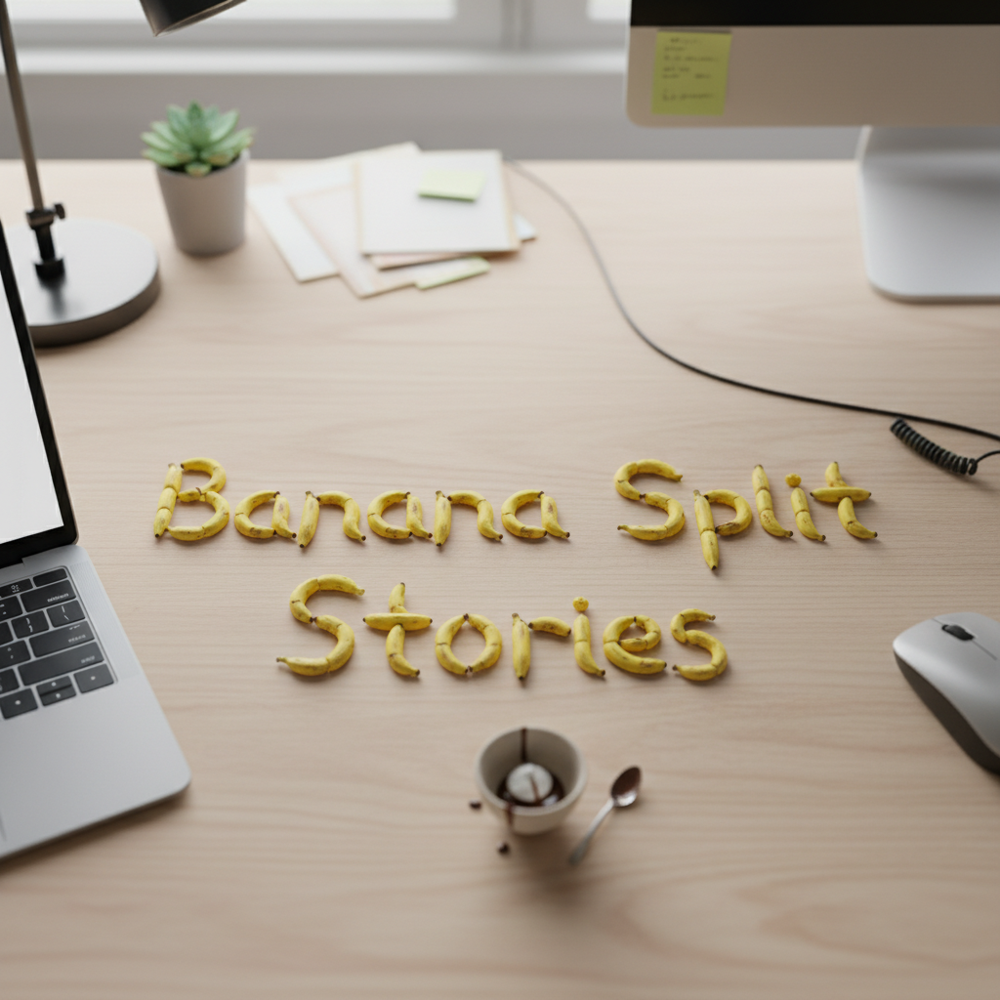

In [8]:
# The text prompt for image generation
prompt = "Create a landscape photorealistic top view image of nano bananas ordered to say `Banana Split Stories` on a computer desk"

print("Generating image...")

# Call the API to generate the image
response = client.models.generate_content(
    model=MODEL_ID,
    contents=prompt,
)

save_and_display_response(response=response, file_name="banner.png")


Generating image...


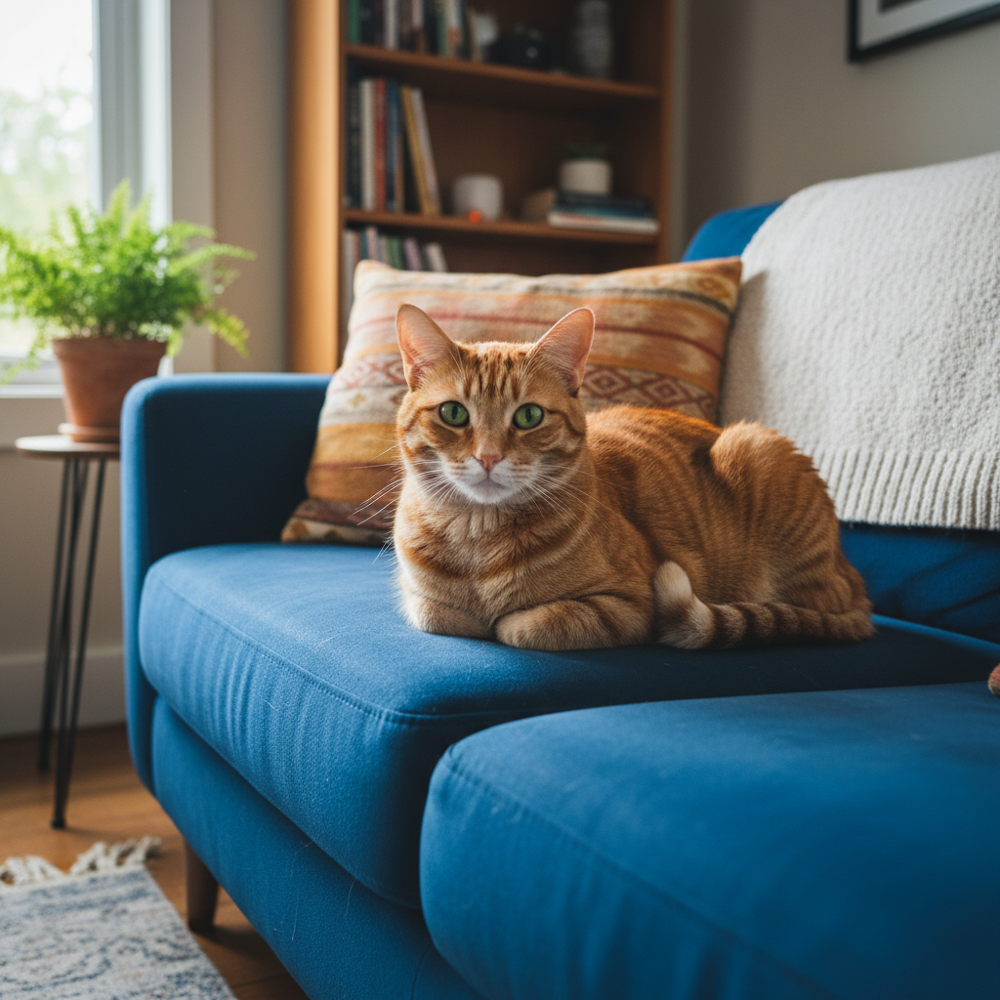

In [ ]:
# The text prompt for image generation
prompt = "Create a photorealistic image of an orange cat with green eyes, sitting on a couch."

print("Generating image...")

# Call the API to generate the image
response = client.models.generate_content(
    model=MODEL_ID,
    contents=prompt,
)

save_and_display_response(response=response, file_name="hello_kitty.png")
 


#### Observations
* The images take ~6 seconds to generate, so if we want to create whole game in real time this might a min or so to generate all images, unless we prepare the prompt and make multiple calls in parallel

### Edit Images

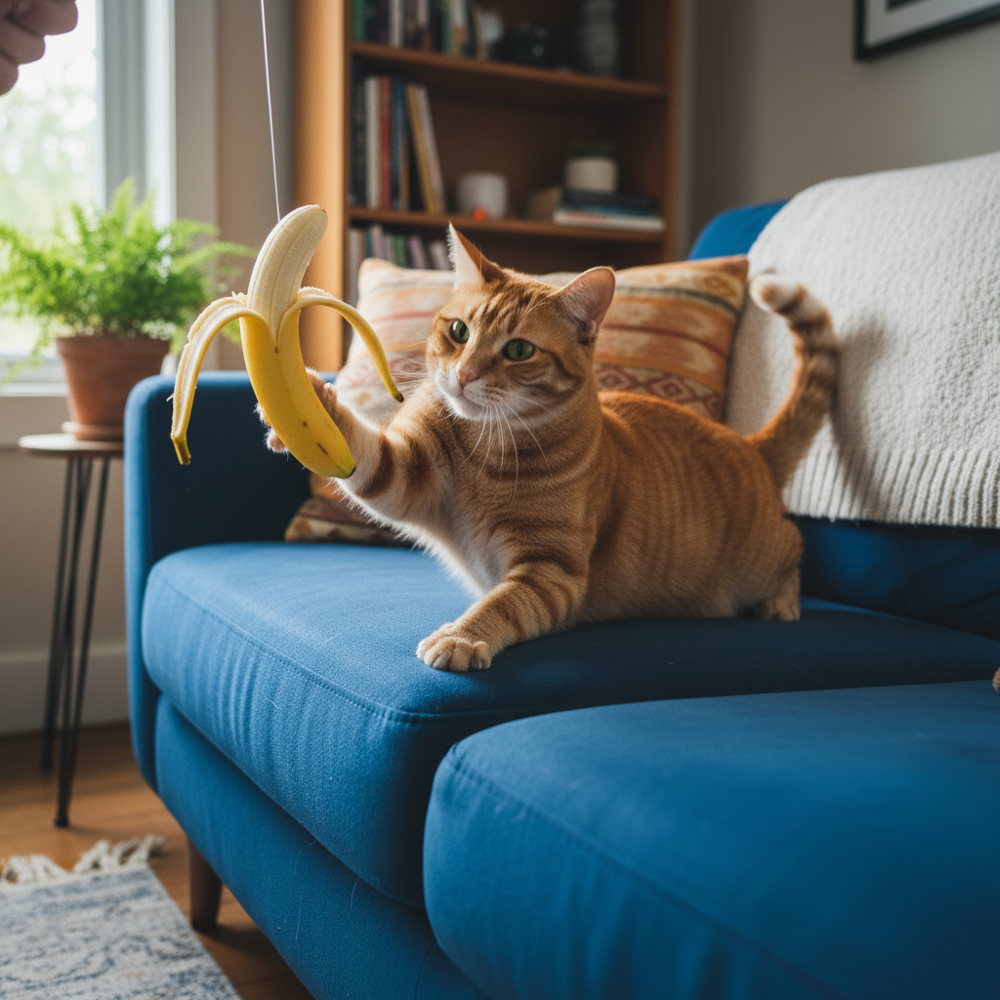

In [14]:
ai_generated_image = Path(ai_image_dir, "hello_kitty.png")

text_prompt = "Make that cat jump with excitement to grab a banana on a fishing pole" 

response = client.models.generate_content(
    model=MODEL_ID,
    contents=[
        text_prompt,
        PIL.Image.open(ai_generated_image)
    ]
)

save_and_display_response(response=response,file_name="hello_jumping_kitty.png")

### Multiple Images
* This might be useful to us for our story game

In [38]:
from IPython.display import display, Markdown


prompt = "Create a beautifully entertaining 8 part story with 8 images with two blue characters and their adventures in the 1960s music scene. The story is thrilling throughout with emotional highs and lows and ending on a great twist and high note. Do not include any words or text on the images but tell the story purely through the imagery itself. " # @param ["Show me how to bake macarons with images","Create a beautifully entertaining 8 part story with 8 images with two blue characters and their adventures in the 1960s music scene. The story is thrilling throughout with emotional highs and lows and ending on a great twist and high note. Do not include any words or text on the images but tell the story purely through the imagery itself. "] {"allow-input":true}

response = client.models.generate_content(
    model=MODEL_ID,
    contents=prompt,
)


def display_response(response):
  for part in response.parts:
    if part.text:
      display(Markdown(part.text))
    elif image:= part.as_image():
      display(image)


display_response(response=response)

**Part 1: The Dream Begins**

In the vibrant, smoky clubs of 1960s London, two azure-skinned dreamers, Art and BeBop, watch a band on stage, their eyes filled with ambition. The energy of the crowd and the rhythm of the music ignite a spark within them. They exchange a look, a silent promise to chase their own musical destiny.


Image(
  image_bytes=b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHDR\x00\x00\x04\x00\x00\x00\x04\x00\x08\x02\x00\x00\x00\xf0\x7f\xbc\xd4\x00\x00 \x00IDATx\x9cl\xfd\xc9\xb2m\xdb\xb2,\x06\xb9G\xebc\xeds\x13!==\x19 \x89\xac\x04e\xfe\x80\xff\xa0\xc4\xa7Q\xe43\xa0\x04FU%\x0c!3\x81\x19B\x80\x84\xde\xbb\xef\xe9\x9c5z...',
  mime_type='image/png'
)



**Part 2: The First Gig**

Art, with his wild, curly blue hair, passionately plays his electric guitar, while BeBop, sleek and cool with his upright bass, lays down a groovy rhythm. They're on a tiny, makeshift stage, a single bare bulb illuminating their raw talent. The few onlookers, initially curious, are slowly captivated by their unique sound.


Image(
  image_bytes=b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHDR\x00\x00\x04\x00\x00\x00\x04\x00\x08\x02\x00\x00\x00\xf0\x7f\xbc\xd4\x00\x00 \x00IDATx\x9ct\xfd]\xcf\xb6]\x97%\x04\x8d1\xd7q\xde\xf7\xf3\xbcUEU\xd34\xa84\x08\xad\x04\x83\x06\x15\x8d[\xb8\xa3\x89\xdb\xfe\x05\x7f\x81?\xc0\x1f\xe0\xb6\tl\x18\xdds\x03\x12\xa3\x06...',
  mime_type='image/png'
)



**Part 3: The Ascent**

Fame begins to beckon. Art and BeBop are now playing to a packed house, the crowd a blur of dancing figures and admiring faces. Stage lights flash, highlighting their confident smiles and the undeniable chemistry between them. Their music is infectious, their presence electrifying.


Image(
  image_bytes=b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHDR\x00\x00\x04\x00\x00\x00\x04\x00\x08\x02\x00\x00\x00\xf0\x7f\xbc\xd4\x00\x00 \x00IDATx\x9c|\xfd\xdd\xb2\xa49\x8e$\x08\xaa\x82\xc73\xb3\xaawjz/F\xf6f\xdf\xff\xf9vEF\xaa\xbb+\xdd\x80\xbdPU\x90\xe6\x91\xbd^\x95\x11\xe1\xe7\x98}\x1f\t\x02\n\xc5\x0fI...',
  mime_type='image/png'
)



**Part 4: The Pressure Cooker**

The whirlwind of success takes its toll. Art and BeBop are in a recording studio, surrounded by sound engineers and complex equipment. Tensions are high; Art looks frustrated, his hands running through his hair, while BeBop tries to mediate, his expression strained. The magic of their collaboration seems to waver under the immense pressure.


Image(
  image_bytes=b"\x89PNG\r\n\x1a\n\x00\x00\x00\rIHDR\x00\x00\x04\x00\x00\x00\x04\x00\x08\x02\x00\x00\x00\xf0\x7f\xbc\xd4\x00\x00 \x00IDATx\x9ct\xfd\xdd\x9a\x1d\xb9\xae$\x08\x9a\xc1C\xa9]\xfdu\xd7\xbc\xff[\xce\xf4M\xedLi\x11saf\x00=\x94GU'\xb7\x14\xb1\x96;\t\x02\x06\xc3\x0fI\xfe\xaf\xbf\xfe7\x89&...',
  mime_type='image/png'
)

**Part 5: The Rift**

The rift widens. Art is on stage alone, a spotlight harsh on his solitary figure, his guitar wailing a mournful tune. In the background, BeBop stands by the side of the stage, his back to Art, his expression unreadable. The once harmonious duo is clearly fractured, their separate paths evident.


Image(
  image_bytes=b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHDR\x00\x00\x04\x00\x00\x00\x04\x00\x08\x02\x00\x00\x00\xf0\x7f\xbc\xd4\x00\x00 \x00IDATx\x9ct\xfd\xeb\x96$9\xae3\n\x02\x94EV\x9f\xb3\xd6\xcc\xfb\xbf\xe8\xcc\xd9]\xe1F\xce\x0f\x02\xa4<\xf77\xd1\xd5\x99\x91~1\x93(\x12\x04/\x92\xf1\xff\xfa\xf3\xff"Y(\xa0@...',
  mime_type='image/png'
)



**Part 6: A Chance Encounter**

Years later, the two blue figures, older and perhaps a little wiser, cross paths by chance in a bustling 1960s city street. They freeze, surprise and a hint of sadness in their eyes. The world rushes by around them, but for a moment, they are isolated in their shared history.


Image(
  image_bytes=b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHDR\x00\x00\x04\x00\x00\x00\x04\x00\x08\x02\x00\x00\x00\xf0\x7f\xbc\xd4\x00\x00 \x00IDATx\x9cL\xfdM\xb3m\xdb\x92\x1c\x08\xb9G\xc4\x98k\xed}\xee\xc7{\xf92SR\x16R\xa1B%\x8c2\x95\x81\x01\x86\x0c\x0c\x03\xa3E\x83\xdf\xc0\x9f\xa4\x8d\xd1*\xab\x06\r\xacJ\x85\x95...',
  mime_type='image/png'
)



**Part 7: The Reunion**

The magic is rekindled. Art and BeBop are back on stage together, performing with an even deeper understanding and joy. The crowd is ecstatic, dancing with unbridled enthusiasm. The stage is bathed in warm, vibrant lights, reflecting the renewed warmth of their friendship and collaboration.


Image(
  image_bytes=b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHDR\x00\x00\x04\x00\x00\x00\x04\x00\x08\x02\x00\x00\x00\xf0\x7f\xbc\xd4\x00\x00 \x00IDATx\x9c\\\xfd\xd7\x9at9\xce#\x8c\x02T\xf6g\xe6\x7f\xf6\xfd_\xec\xd4\x12\xf6\x01\x00*j\xaa\xbb\xcc\x9b\x19\xb1\x8cD\x03\x82F\xfc\xef\xbf\xff\x1f\t\x91\x92\x08\x12\x80\x00\n\x18\xe0\x02\x84...',
  mime_type='image/png'
)

In [23]:
for part in response.parts:
    if part.inline_data:
      image = part.as_image()
      image.save(f"{ai_image_dir}/temp_{datetime.now().timestamp()}.png")
      display(image)
      
    #   image_parts = [
    #     part.inline_data.data
    #     for part in response.candidates[0].content.parts
    #     if part.inline_data
    #   ]
    
    # if image_parts:
    #     image = Image.open(BytesIO(image_parts[0]))
    #     image.save(f"{ai_image_dir}/temp_{datetime.now().timestamp()}")
    #     display(image)

Image(
  image_bytes=b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHDR\x00\x00\x04\x00\x00\x00\x04\x00\x08\x02\x00\x00\x00\xf0\x7f\xbc\xd4\x00\x00 \x00IDATx\x9cT\xfd\xd1\x92,I\xae$\x88\xa9\x02f\x1ey\xaa\xbbg\xef\xec\x90\x14Y\xee7\xf0\x03\xf8\xca\xff\xff\x0c\n\x85\xfb0+2s\xbb\xebd\x84\x1b\xa0|PxV\xb3\xef\xc3\xed\xae:...',
  mime_type='image/png'
)

Image(
  image_bytes=b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHDR\x00\x00\x04\x00\x00\x00\x04\x00\x08\x02\x00\x00\x00\xf0\x7f\xbc\xd4\x00\x00 \x00IDATx\x9cL\xfd[\xafmi\x92%\x08\x8dafs\xeds<.y-\xaa\xbb:\xa1\xa5\x02\xd4\xa2\x91@\xa8^\x10\xafH\x887~)\xff\x81\xdf\xc0\x1bH\xa8\x9a\xee\xa2\xaa/U\x95\x99\x15...',
  mime_type='image/png'
)

Image(
  image_bytes=b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHDR\x00\x00\x04\x00\x00\x00\x04\x00\x08\x02\x00\x00\x00\xf0\x7f\xbc\xd4\x00\x00 \x00IDATx\x9cL\xfdY\xb0e\xd9y\x1e\x88\xfd\xd3Z{\x9f\xe9\x8e9\xd5<\xa0\nU\xa8\x02@\xa00\x91\x04H\x91-\x89\x9a\xd5j\xd2\x92Z\x14\xc3\x1d\xed\x88\xd6\x83\x1d\xe1\x08\xdb\x11~\xf7\xa3...',
  mime_type='image/png'
)

Image(
  image_bytes=b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHDR\x00\x00\x04\x00\x00\x00\x04\x00\x08\x02\x00\x00\x00\xf0\x7f\xbc\xd4\x00\x00 \x00IDATx\x9cd\xfd\xdb\x82$\xbb\x8e#\n\x02\x94\xaf:\xf3\xff\xbf;;\x84y\x00@Y\x9e\xc9\xae^;3\xc2\xddL\x17\x12\x04/\xa2x\xe6\xff\x03\x80$\x84\xfe\x11@\x00\x00\t\x88\x001\x92...',
  mime_type='image/png'
)

Image(
  image_bytes=b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHDR\x00\x00\x04\x00\x00\x00\x04\x00\x08\x02\x00\x00\x00\xf0\x7f\xbc\xd4\x00\x00 \x00IDATx\x9c\\\xfd\xdb\x96$\xd9\x8d$\n\x8a\x00[\xcd<"\x93\xf7bw?\xcd\x9a5\xff\xffU3k\x9eO1\x99\xccp7\xd5\r\x9c\x07\x11\xa8E\x9d\xecf\x91\x19\xe1n\xa6\xba/\x80@...',
  mime_type='image/png'
)

Image(
  image_bytes=b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHDR\x00\x00\x04\x00\x00\x00\x04\x00\x08\x02\x00\x00\x00\xf0\x7f\xbc\xd4\x00\x00 \x00IDATx\x9cl\xfd\xed\x96m\xb9\x92+\x86\x011\xb3\xfaJ\xb6e{\xf8\xfd\xdf\xd1\x1e\xbe\xb6$\xabO\x12\xfe\x01 \xc8<}w\x9f\xae\xaa\x9d\xb9\xd6\x9cd0>\x10\x9f$\xf9?\r\x84!p...',
  mime_type='image/png'
)

Image(
  image_bytes=b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHDR\x00\x00\x04\x00\x00\x00\x04\x00\x08\x02\x00\x00\x00\xf0\x7f\xbc\xd4\x00\x00 \x00IDATx\x9cd\xfd\xed\xb2%\xd9q$\x8a\xb9G\xac\xdc\xd5\xf8ht74\xc3!u9\xbcf\xd2\x03\xe8\xfd\x9fB/\xa0\x1f2]]\xe3pH\x0e\x06\xec\x06\xd0uv\xaep\xfdp_yj...',
  mime_type='image/png'
)

Image(
  image_bytes=b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHDR\x00\x00\x04\x00\x00\x00\x04\x00\x08\x02\x00\x00\x00\xf0\x7f\xbc\xd4\x00\x00 \x00IDATx\x9c\\\xfd\xed\x96$I\x8e#\x88\x02\x141\xf3\x88\xcc\xaa\x99\xb3\xf7\xfd\x1fq\xcf\xf4tWWf\xb8\x99\nq\x7f\x00T\x8b\xde:\xddU\x99\x11\xeef\xaa\xf2A\x82 H\xf2\xf9\xf8G...',
  mime_type='image/png'
)

For some reason display image is not working, but I was able to save and view the images manually. 

### Converting Selfie Into Characters

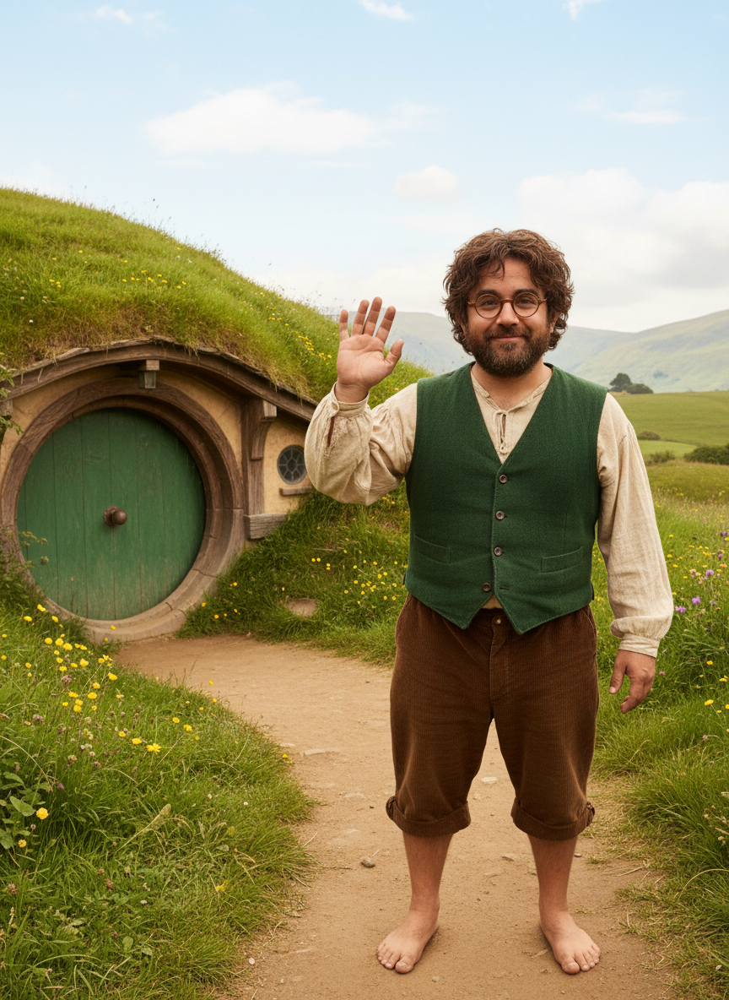

In [46]:
ai_generated_image = Path(image_dir, "me.jpg")

text_prompt = "Convert the subject into image into a hobbit happily waving somewhere in middle earth" 

response = client.models.generate_content(
    model=MODEL_ID,
    contents=[
        text_prompt,
        PIL.Image.open(ai_generated_image)
    ]
)

save_and_display_response(response=response,file_name="me_hobbit.png")

### Chat Mode
* This is the recommended mode for image generation and editing, I want to try this to see if I can generate a image, and in next prompt edit the view point of the image as if the player moved ahead. 

In [47]:
## step 1 - create chat


chat = client.chats.create(
    model=MODEL_ID,
)

In [48]:
## step 2 - send chat message

message = "Concept art, character sheet for Kaelen, a male fantasy rogue with short, dark hair. He has a clever and resourceful expression. He is wearing a practical and worn dark leather jacket over a simple tunic, equipped with various pouches and a sheathed dagger on his belt. Full body portrait against a neutral grey background."
response = chat.send_message(message)

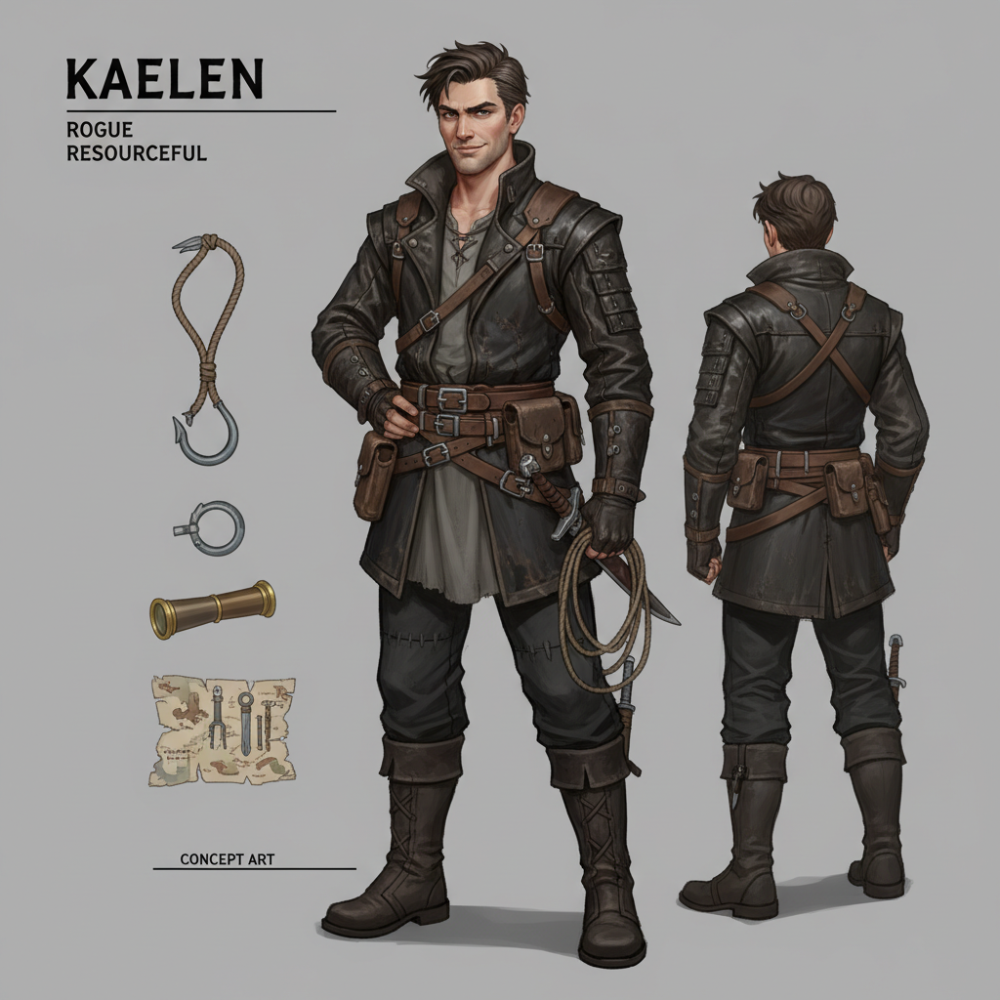

In [49]:
save_and_display_response(response=response,file_name="main_character.png")

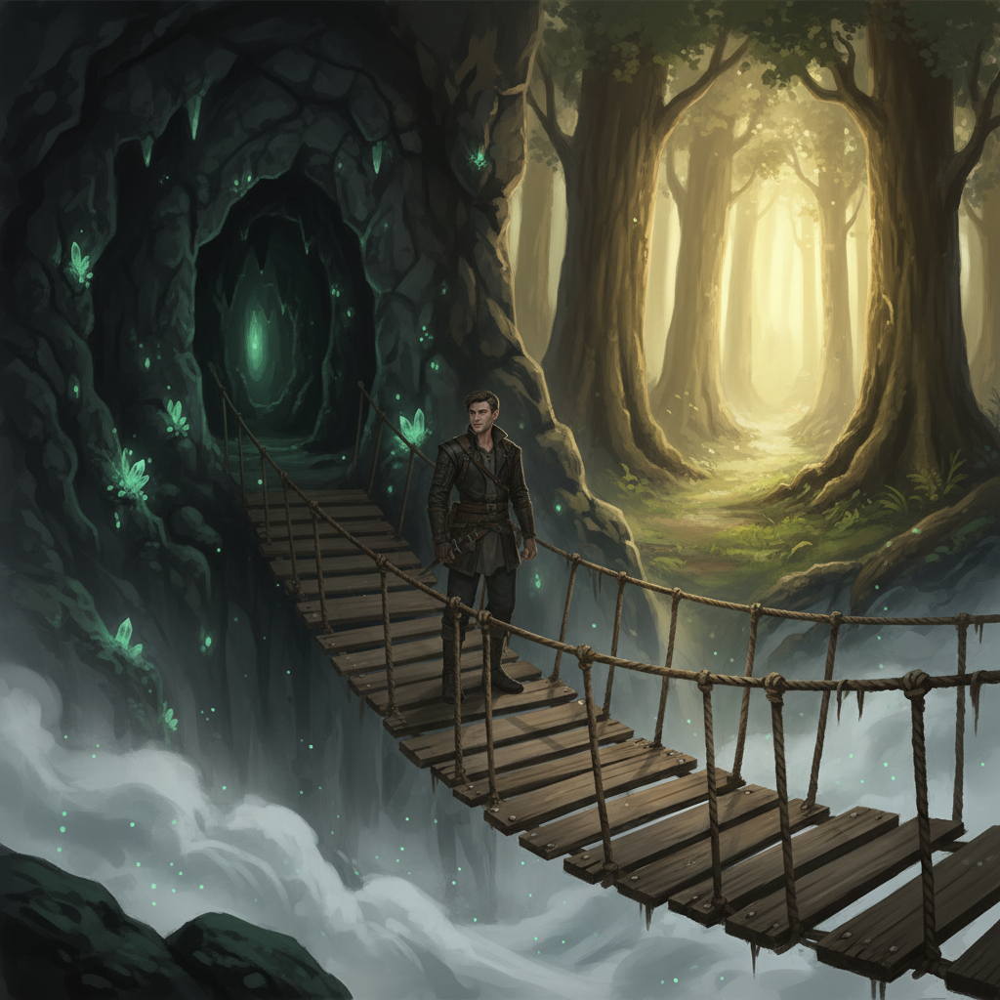

In [51]:
message = "Digital painting, fantasy art style. Kaelen, a rogue with a leather jacket, stands at the center of a rickety rope bridge over a deep, misty chasm. To his left, the bridge leads to a dark cave entrance pulsing with a faint, eerie green light. To his right, the bridge continues towards a sun-dappled, ancient forest. The choice is clear: the ominous cave or the serene forest."

response = chat.send_message(message)

save_and_display_response(response=response,file_name="scene_1.png")

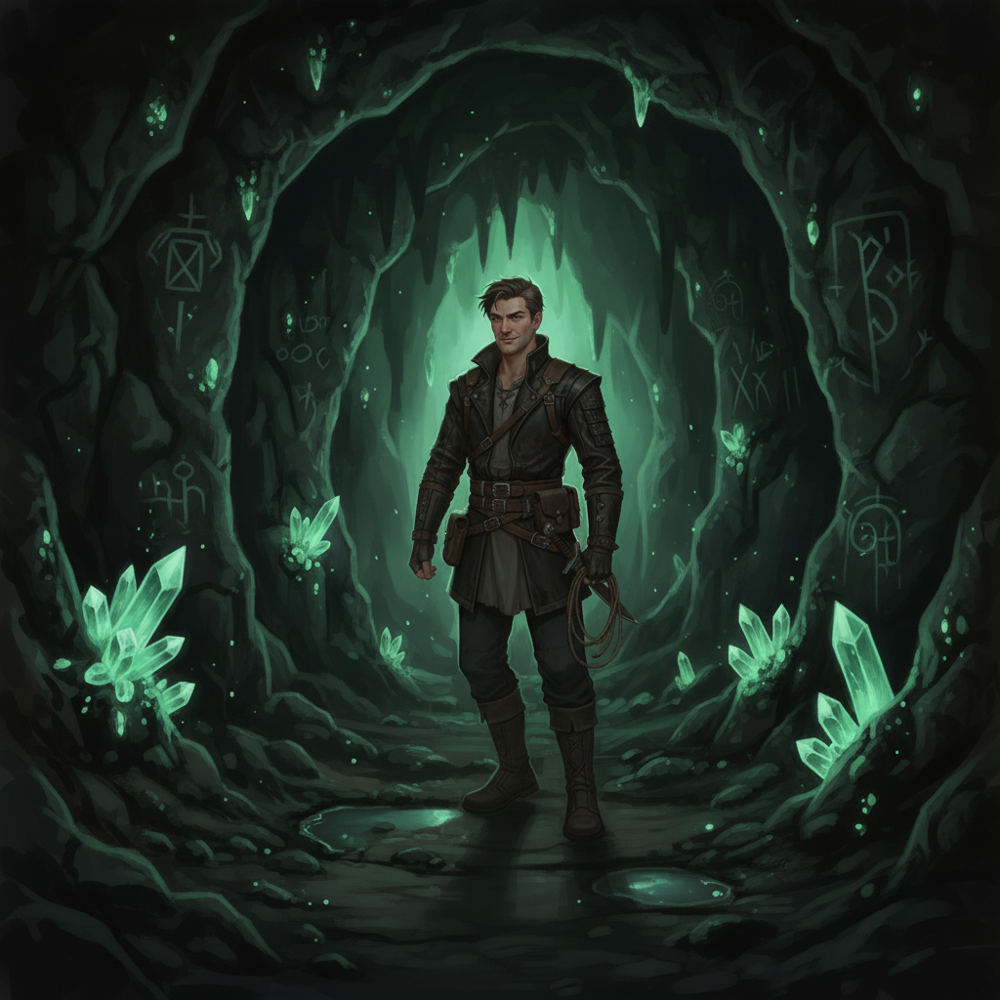

In [52]:
message = "Digital painting, fantasy art style. Inside the dark cave, Kaelen, the rogue with a leather jacket, cautiously steps forward. The only light comes from strange, glowing green crystals on the walls, illuminating ancient, cryptic symbols carved into the stone."

response = chat.send_message(message)

save_and_display_response(response=response,file_name="scene_2.png")

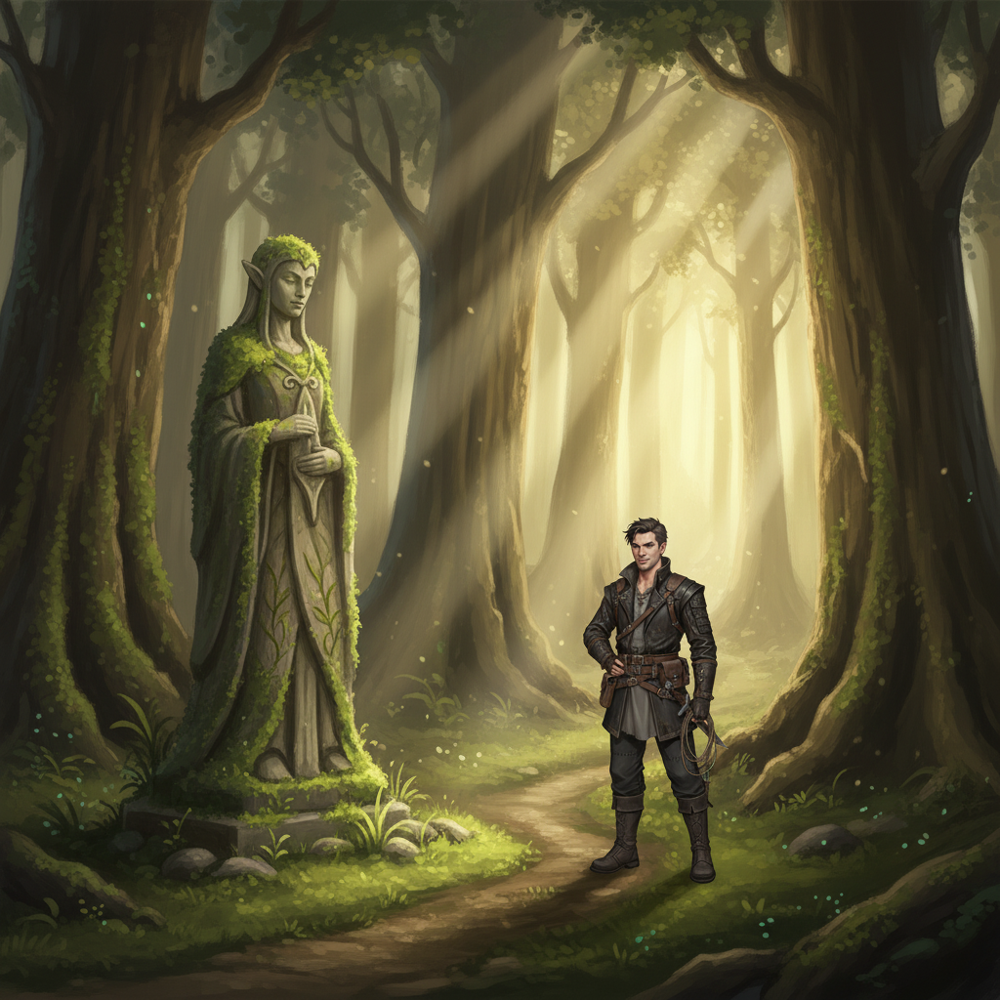

In [53]:
message = "Digital painting, fantasy art style. Having crossed the bridge, Kaelen, the rogue with a leather jacket, enters the sun-dappled ancient forest. Sunbeams filter through the massive, moss-covered trees, and he spots a hidden, mossy elven statue just off the path."

response = chat.send_message(message)

save_and_display_response(response=response,file_name="scene_3.png")